<p style="text-align:center;">
    <font face="Georgia" size=6 color="red"><b>Install & Import Required libraries </b></font>
</p>

<p style="text-align:left;">
    <font face="Georgia" size=4 color="Green"><b>RT-DETRv2</b></font>
</p>

In [1]:
!pip install ultralytics > /dev/null 2>&1
print("Installation completed.")
from ultralytics import RTDETR
model = RTDETR('rtdetr-l.pt')

Installation completed.
Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


100%|██████████| 63.4M/63.4M [00:00<00:00, 236MB/s]


<p style="text-align:left;">
    <font face="Georgia" size=4 color="Green"><b>YOLOv12</b></font>
</p>

In [2]:
!wget https://github.com/sunsmarterjie/yolov12/releases/download/v1.0/yolov12l.pt > /dev/null 2>&1
print("Installation completed.")

Installation completed.


<p style="text-align:left;">
    <font face="Georgia" size=4 color="Green"><b>RT-DETRv3</b></font>
</p>

In [3]:
!git clone https://github.com/clxia12/RT-DETRv3.git
%cd RT-DETRv3

Cloning into 'RT-DETRv3'...
remote: Enumerating objects: 531, done.
remote: Counting objects: 100% (6/6), done.
remote: Compressing objects: 100% (6/6), done.
remote: Total 531 (delta 2), reused 1 (delta 0), pack-reused 525 (from 2)
Receiving objects: 100% (531/531), 6.93 MiB | 27.93 MiB/s, done.
Resolving deltas: 100% (116/116), done.
/kaggle/working/RT-DETRv3


In [4]:
!pip install -r requirements.txt > /dev/null 2>&1
print("Installation completed.")


Installation completed.


In [6]:
!mkdir -p checkpoints
!gdown https://drive.google.com/uc?id=1zIDOjn1qDccC3TBsDlGQHOjVrehd26bk -O checkpoints/rtdetrv3_r18vd_6x.pdparams


Downloading...
From: https://drive.google.com/uc?id=1zIDOjn1qDccC3TBsDlGQHOjVrehd26bk
To: /kaggle/working/RT-DETRv3/checkpoints/rtdetrv3_r18vd_6x.pdparams
100%|███████████████████████████████████████| 91.9M/91.9M [00:00<00:00, 266MB/s]


In [5]:
!mkdir -p checkpoints
!gdown https://drive.google.com/uc?id=1wfJE-QgdgqKE0IkiTuoD5HEbZwwZg3sQ -O checkpoints/rtdetrv3_r50vd_6x.pdparams

Downloading...
From (original): https://drive.google.com/uc?id=1wfJE-QgdgqKE0IkiTuoD5HEbZwwZg3sQ
From (redirected): https://drive.google.com/uc?id=1wfJE-QgdgqKE0IkiTuoD5HEbZwwZg3sQ&confirm=t&uuid=29332af1-07a0-4147-b096-c0e16aee6d54
To: /kaggle/working/RT-DETRv3/checkpoints/rtdetrv3_r50vd_6x.pdparams
100%|████████████████████████████████████████| 182M/182M [00:03<00:00, 55.8MB/s]


In [6]:
!pip install paddlepaddle-gpu==2.6.2 -f https://paddlepaddle.org.cn/whl/linux/mkl/avx/stable.html  > /dev/null 2>&1
print("Installation completed.")

Installation completed.


In [7]:
import paddle
print(paddle.is_compiled_with_cuda())  
print(paddle.get_device())  

True
gpu:0


In [8]:
!pip install paddledet > /dev/null 2>&1
print("Installation completed.")


Installation completed.


In [9]:
%cd /kaggle/working/RT-DETRv3/ppdet/ext_op
!python setup.py install
import ppdet
print("ppdet successfully imported!")

/kaggle/working/RT-DETRv3/ppdet/ext_op
/usr/local/lib/python3.10/dist-packages/setuptools/_distutils/cmd.py:66: SetuptoolsDeprecationWarning: setup.py install is deprecated.
!!

        ********************************************************************************
        Please avoid running ``setup.py`` directly.
        Instead, use pypa/build, pypa/installer or other
        standards-based tools.

        See https://blog.ganssle.io/articles/2021/10/setup-py-deprecated.html for details.
        ********************************************************************************

!!
  self.initialize_options()
/usr/local/lib/python3.10/dist-packages/setuptools/_distutils/cmd.py:66: EasyInstallDeprecationWarning: easy_install command is deprecated.
!!

        ********************************************************************************
        Please avoid running ``setup.py`` and ``easy_install``.
        Instead, use pypa/build, pypa/installer or other
        standards-based to

In [15]:
!pip install /kaggle/working/RT-DETRv3/ppdet/ext_op > /dev/null 2>&1
print("Installation completed.")

Installation completed.


<p style="text-align:center;">
    <font face="Georgia" size=7 color="red"><b>Part 1</b></font>
</p>

<p style="text-align:center;">
    <font face="Georgia" size=5 color="red"><b>RTDETRv3_ s</b></font>
</p>

<p style="text-align:center;">
    <font face="Georgia" size=5 color="red"><b>Select Image
</b></font>
</p>

In [16]:
import requests
from PIL import Image
from io import BytesIO
import matplotlib.pyplot as plt

# URL for bus image
url_bus = "https://github.com/ultralytics/yolov5/releases/download/v1.0/bus.jpg"

# Request the image from the URL
response = requests.get(url_bus)
if response.status_code == 200:
    
    img_bus = Image.open(BytesIO(response.content))
    
    # Save the image to the specified path
    img_bus.save("/kaggle/working/RT-DETRv3/coco_sample.jpg")
    print("Bus image downloaded successfully.")
else:
    print("Failed to download bus image.")

# Load images for further processing
original_images = {
    "Bus": Image.open('/kaggle/working/RT-DETRv3/coco_sample.jpg'),  
    "VisDrone": Image.open('/kaggle/input/visdrone2019-det/VisDrone/images/train/0000002_00005_d_0000014.jpg')
}


Bus image downloaded successfully.


<p style="text-align:center;">
    <font face="Georgia" size=5 color="red"><b>Display Image</b></font>
</p>

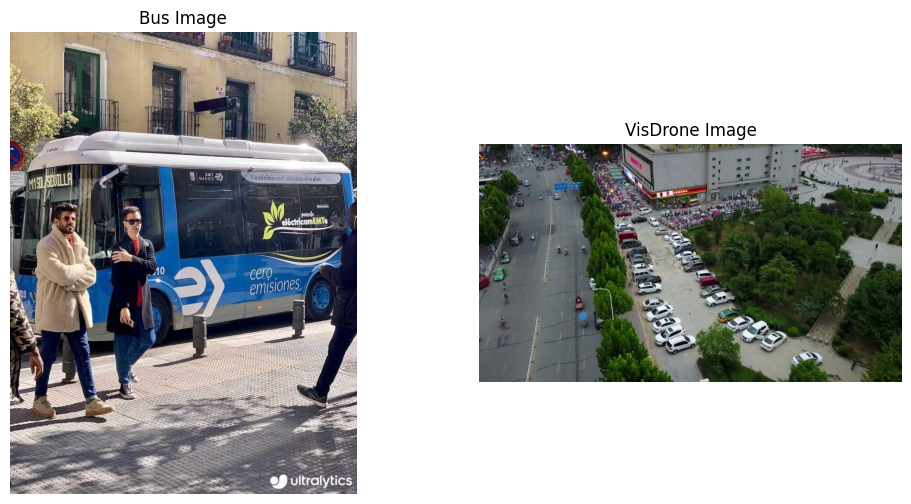

In [17]:
# Load the images
img_bus = Image.open('/kaggle/working/RT-DETRv3/coco_sample.jpg')  
img_visdrone = Image.open('/kaggle/input/visdrone2019-det/VisDrone/images/train/0000002_00005_d_0000014.jpg')

# Display the images in one row with two columns
fig, axes = plt.subplots(1, 2, figsize=(12, 6))

# Display the Bus Image
axes[0].imshow(img_bus)
axes[0].set_title("Bus Image")
axes[0].axis('off') 

# Display the VisDrone Image
axes[1].imshow(img_visdrone)
axes[1].set_title("VisDrone Image")
axes[1].axis('off')  

# Show the plot
plt.show()


In [108]:
# Check the dimensions of the images
print("Bus Image dimensions:", img_bus.size)  
print("VisDrone Image dimensions:", img_visdrone.size)  


Bus Image dimensions: (810, 1080)
VisDrone Image dimensions: (960, 540)


In [18]:
# FileNotFoundError: [Errno 2] No such file or directory: 'dataset/coco/annotations/instances_val2017.json'
%cd /kaggle/working/RT-DETRv3
!mkdir -p dataset/coco/annotations
!wget -q http://images.cocodataset.org/annotations/annotations_trainval2017.zip -P dataset/coco/
!unzip -q dataset/coco/annotations_trainval2017.zip -d dataset/coco/

/kaggle/working/RT-DETRv3


<p style="text-align:center;">
    <font face="Georgia" size=5 color="red"><b>Prediction with RT-DETRv3_s</b></font>
</p>

In [27]:
%cd /kaggle/working/RT-DETRv3
!python tools/infer.py \
  -c configs/rtdetrv3/rtdetrv3_r18vd_6x_coco.yml \
  -o weights=checkpoints/rtdetrv3_r18vd_6x.pdparams \
  --infer_img=/kaggle/working/RT-DETRv3/coco_sample.jpg \
  --output_dir=output/r18_bus\
  --draw_threshold=0.2 \
  --save_threshold=0.2

!python tools/infer.py \
  -c configs/rtdetrv3/rtdetrv3_r18vd_6x_coco.yml \
  -o weights=checkpoints/rtdetrv3_r18vd_6x.pdparams \
  --infer_img=/kaggle/input/visdrone2019-det/VisDrone/images/train/0000002_00005_d_0000014.jpg \
  --output_dir=output/r18_visdrone\
  --draw_threshold=0.2 \
  --save_threshold=0.2


/kaggle/working/RT-DETRv3
W0610 17:33:09.168905   454 gpu_resources.cc:119] Please NOTE: device: 0, GPU Compute Capability: 7.5, Driver API Version: 12.6, Runtime API Version: 11.8
W0610 17:33:09.170223   454 gpu_resources.cc:164] device: 0, cuDNN Version: 8.9.
[06/10 17:33:10] ppdet.utils.checkpoint INFO: Finish loading model weights: checkpoints/rtdetrv3_r18vd_6x.pdparams
loading annotations into memory...
Done (t=0.67s)
creating index...
index created!
loading annotations into memory...
Done (t=0.71s)
creating index...
index created!
100%|█████████████████████████████████████████████| 1/1 [00:00<00:00,  3.95it/s]
[06/10 17:33:12] ppdet.engine INFO: Detection bbox results save in output/r18_bus/coco_sample.jpg
W0610 17:33:15.895602   477 gpu_resources.cc:119] Please NOTE: device: 0, GPU Compute Capability: 7.5, Driver API Version: 12.6, Runtime API Version: 11.8
W0610 17:33:15.896821   477 gpu_resources.cc:164] device: 0, cuDNN Version: 8.9.
[06/10 17:33:16] ppdet.utils.checkpoint IN

<p style="text-align:center;">
    <font face="Georgia" size=5 color="red"><b>Show Results</b></font>
</p>

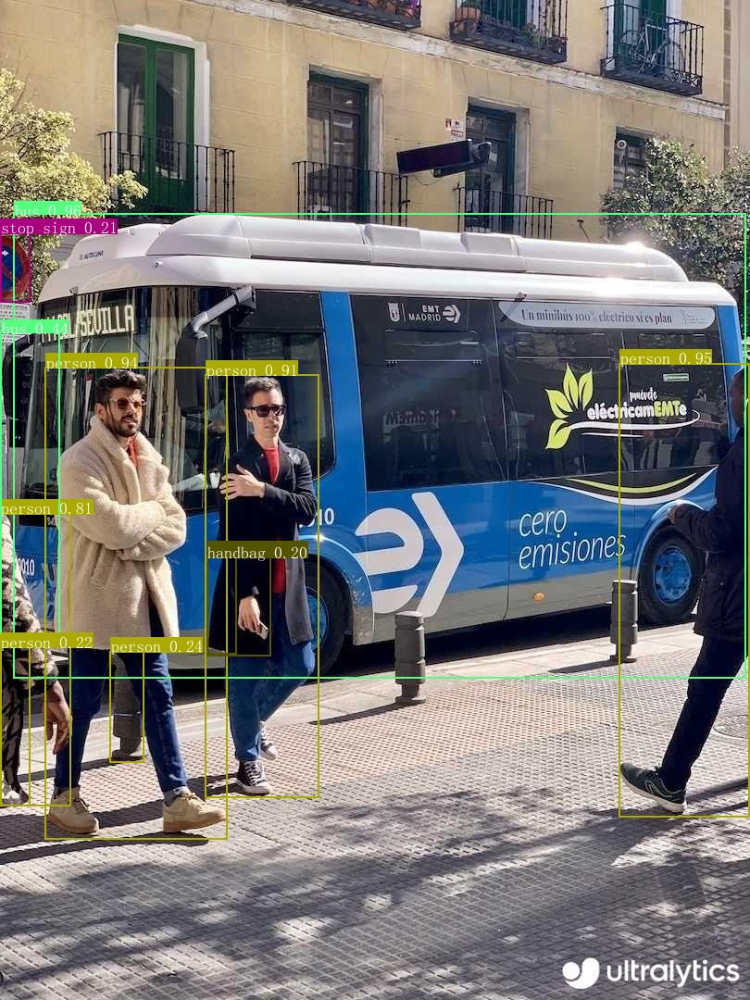

In [28]:

Image.open('output/r18_bus/coco_sample.jpg')


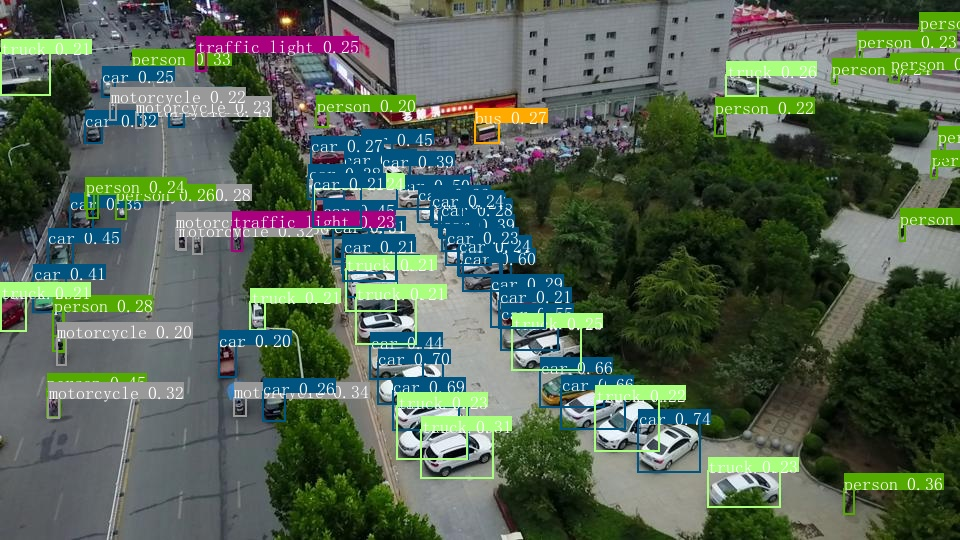

In [29]:
Image.open('/kaggle/working/RT-DETRv3/output/r18_visdrone/0000002_00005_d_0000014.jpg')

<p style="text-align:center;">
    <font face="Georgia" size=5 color="red"><b>RTDETRv3_ l </b></font>
</p>

<p style="text-align:center;">
    <font face="Georgia" size=5 color="red"><b>Prediction with RT-DETRv3_l</b></font>
</p>

In [31]:
%cd /kaggle/working/RT-DETRv3

# ResNet 50 on the bus image
!python tools/infer.py \
  -c configs/rtdetrv3/rtdetrv3_r50vd_6x_coco.yml \
  -o weights=checkpoints/rtdetrv3_r50vd_6x.pdparams \
  --infer_img=coco_sample.jpg \
  --output_dir=output/r50_bus\
  --draw_threshold=0.2 \
  --save_threshold=0.2


# ResNet 50 on the VisDrone image
!python tools/infer.py \
  -c configs/rtdetrv3/rtdetrv3_r50vd_6x_coco.yml \
  -o weights=checkpoints/rtdetrv3_r50vd_6x.pdparams \
  --infer_img=/kaggle/input/visdrone2019-det/VisDrone/images/train/0000002_00005_d_0000014.jpg \
  --output_dir=output/r50_visdrone\
  --draw_threshold=0.2 \
  --save_threshold=0.2


/kaggle/working/RT-DETRv3
W0610 17:35:17.720844   502 gpu_resources.cc:119] Please NOTE: device: 0, GPU Compute Capability: 7.5, Driver API Version: 12.6, Runtime API Version: 11.8
W0610 17:35:17.722151   502 gpu_resources.cc:164] device: 0, cuDNN Version: 8.9.
[06/10 17:35:19] ppdet.utils.checkpoint INFO: Finish loading model weights: checkpoints/rtdetrv3_r50vd_6x.pdparams
loading annotations into memory...
Done (t=0.69s)
creating index...
index created!
loading annotations into memory...
Done (t=0.70s)
creating index...
index created!
100%|█████████████████████████████████████████████| 1/1 [00:00<00:00,  3.65it/s]
[06/10 17:35:21] ppdet.engine INFO: Detection bbox results save in output/r50_bus/coco_sample.jpg
W0610 17:35:24.911113   525 gpu_resources.cc:119] Please NOTE: device: 0, GPU Compute Capability: 7.5, Driver API Version: 12.6, Runtime API Version: 11.8
W0610 17:35:24.912569   525 gpu_resources.cc:164] device: 0, cuDNN Version: 8.9.
[06/10 17:35:26] ppdet.utils.checkpoint IN

<p style="text-align:center;">
    <font face="Georgia" size=5 color="red"><b>Show Results</b></font>
</p>

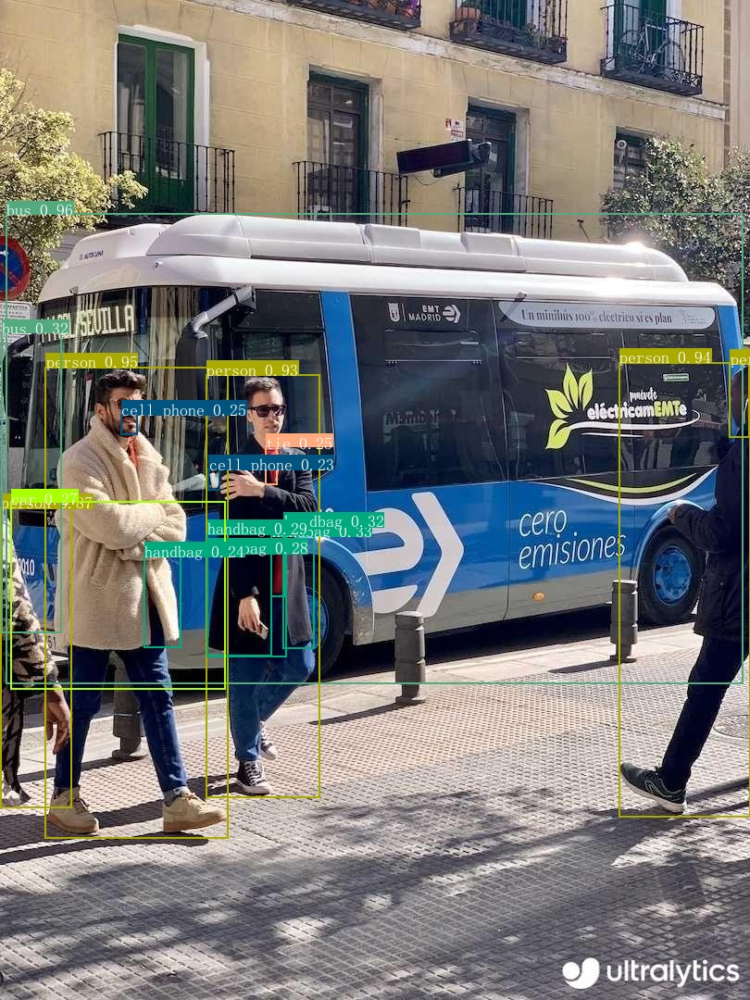

In [35]:
Image.open('/kaggle/working/RT-DETRv3/output/r50_bus/coco_sample.jpg')


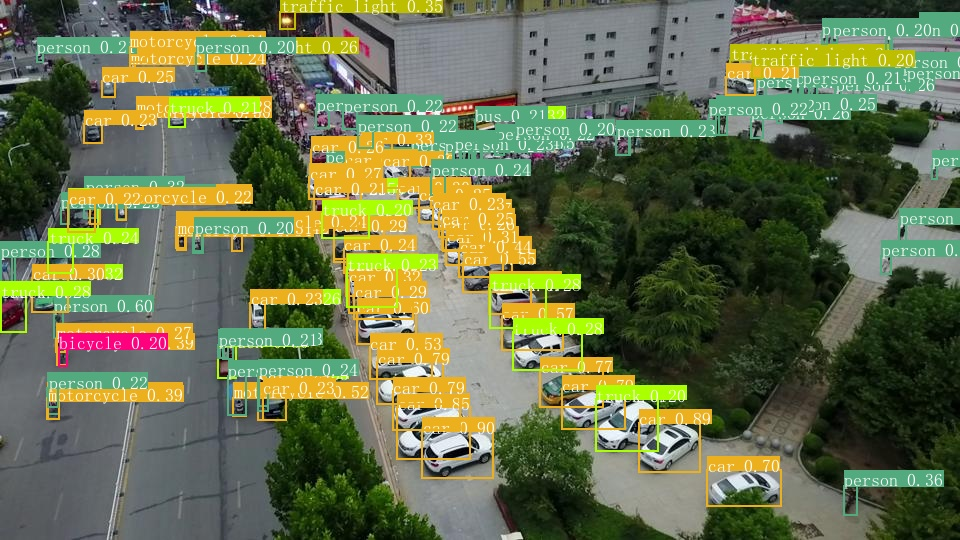

In [33]:
Image.open('/kaggle/working/RT-DETRv3/output/r50_visdrone/0000002_00005_d_0000014.jpg')

<p style="text-align:center;">
    <font face="Georgia" size=5 color="red"><b>YOLOv12 </b></font>
</p>

<p style="text-align:center;">
    <font face="Georgia" size=5 color="red"><b> Prediction with YOLOv12_l</b></font>
</p>


0: 640x480 4 persons, 1 bus, 1 tie, 192.5ms
Speed: 12.0ms preprocess, 192.5ms inference, 682.2ms postprocess per image at shape (1, 3, 640, 480)
Saved Bus result to output/Bus_yolo_result.jpg


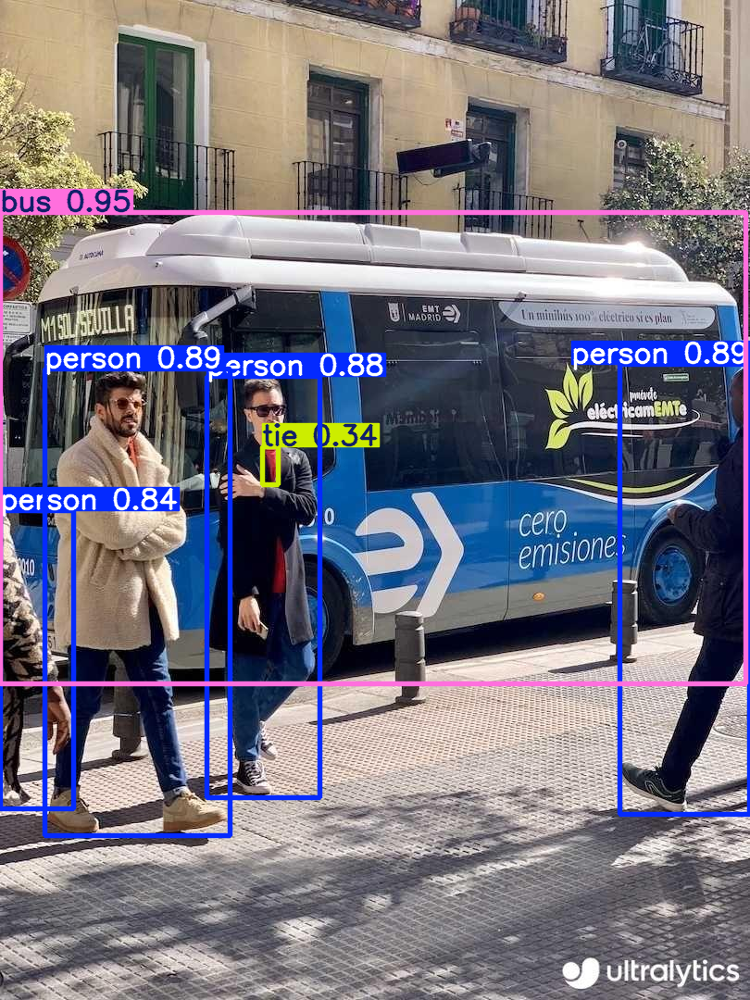


0: 384x640 15 cars, 66.2ms
Speed: 1.8ms preprocess, 66.2ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)
Saved VisDrone result to output/VisDrone_yolo_result.jpg


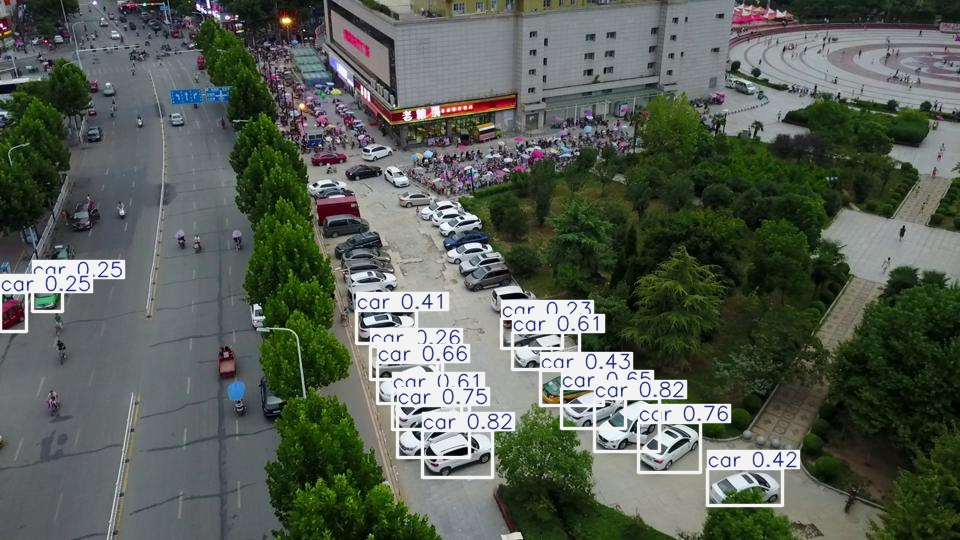

In [36]:
from ultralytics import YOLO

# Load images
original_images = {
    "Bus": Image.open('coco_sample.jpg'),
    "VisDrone": Image.open('/kaggle/input/visdrone2019-det/VisDrone/images/train/0000002_00005_d_0000014.jpg')
}

# Output directory
output_dir = 'output/'

# Load YOLOv12-Large model from custom .pt file
yolo_model = YOLO("/kaggle/working/yolov12l.pt")

# Loop through images and display results one by one for YOLO
for img_title in original_images.keys():
    # Run inference on each image for YOLO
    yolo_result = yolo_model(original_images[img_title] , conf=0.2)
    
    # Create output file path for saving
    output_path = f"{output_dir}{img_title}_yolo_result.jpg"
    
    # Save the result for YOLO
    yolo_result[0].save(output_path)  
    print(f"Saved {img_title} result to {output_path}")
    
    # Show the image with bounding boxes
    yolo_result[0].show()  

<p style="text-align:center;">
    <font face="Georgia" size=5 color="red"><b>RTDETRv2_l </b></font>
</p>

<p style="text-align:center;">
    <font face="Georgia" size=5 color="red"><b> Prediction with RT_DETRv2_l</b></font>
</p>


0: 640x640 4 persons, 1 bus, 1 traffic light, 1 fire hydrant, 1 handbag, 1 tie, 68.6ms
Speed: 3.3ms preprocess, 68.6ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)
Saved Bus result to output/Bus_rtdetr_result.jpg


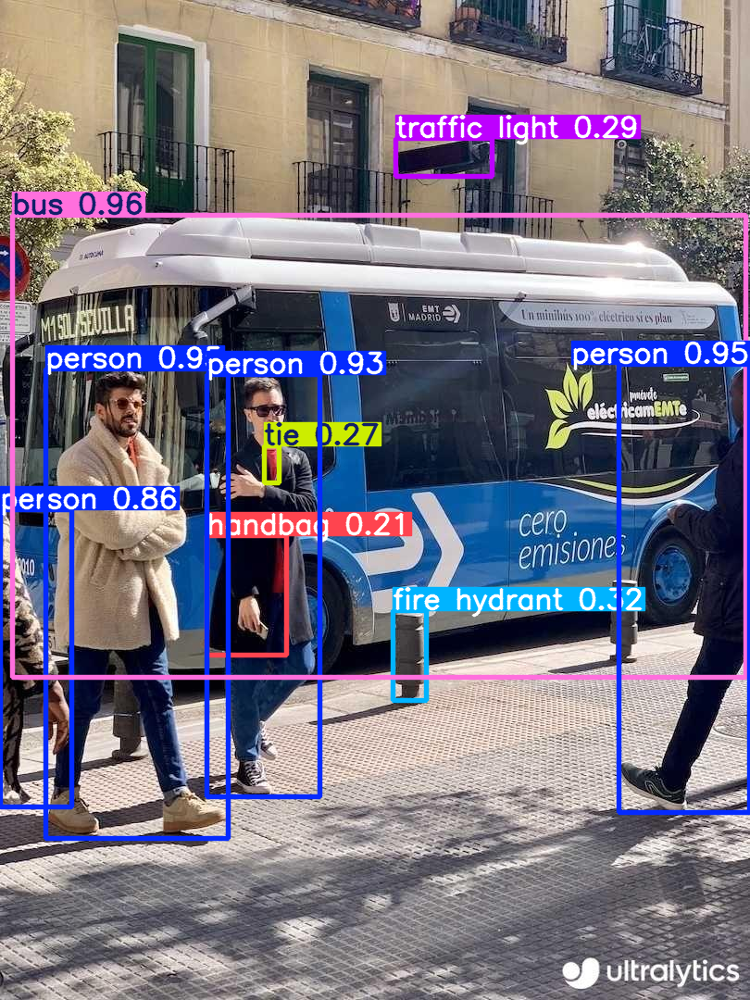


0: 640x640 24 persons, 29 cars, 14 motorcycles, 23 trucks, 2 traffic lights, 68.2ms
Speed: 2.2ms preprocess, 68.2ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)
Saved VisDrone result to output/VisDrone_rtdetr_result.jpg


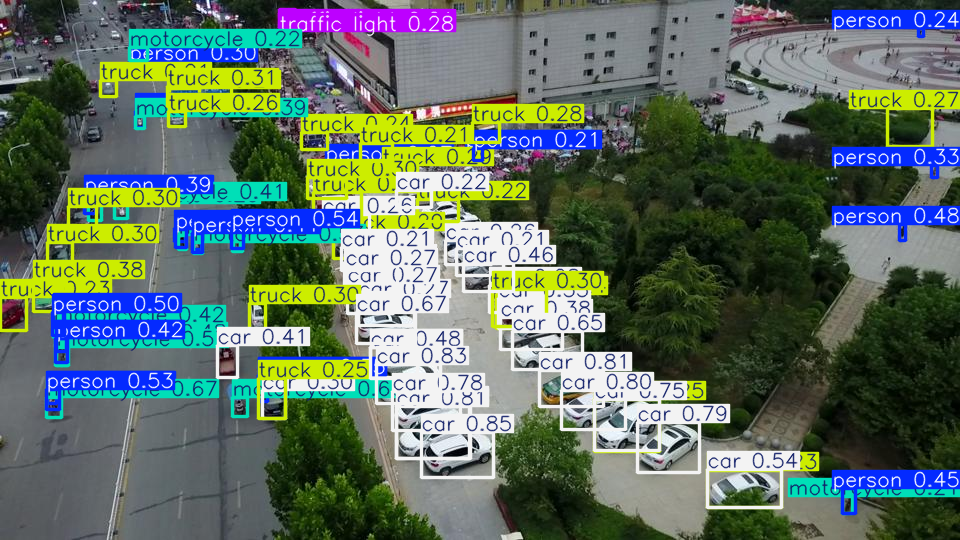

In [37]:
from ultralytics import RTDETR

# Load images
original_images = {
    "Bus": Image.open('coco_sample.jpg'),
    "VisDrone": Image.open('/kaggle/input/visdrone2019-det/VisDrone/images/train/0000002_00005_d_0000014.jpg')
}

# Output directory
output_dir = 'output/'

# Load RT-DETRv2 model from custom .pt file
rt_detr_model = RTDETR("/kaggle/working/rtdetr-l.pt")  

# Loop through images and display results one by one for RT-DETRv2
for img_title in original_images.keys():
    
    rt_detr_result = rt_detr_model(original_images[img_title] , conf=0.2)
    
    # Create output file path for saving
    output_path = f"{output_dir}{img_title}_rtdetr_result.jpg"
    
    # Save the result for RT-DETRv2
    rt_detr_result[0].save(output_path)  
    print(f"Saved {img_title} result to {output_path}")
    
    # Show the image with bounding boxes
    rt_detr_result[0].show()  

<p style="text-align:center;">
    <font face="Georgia" size=5 color="red"><b>Compare</b></font>
</p>

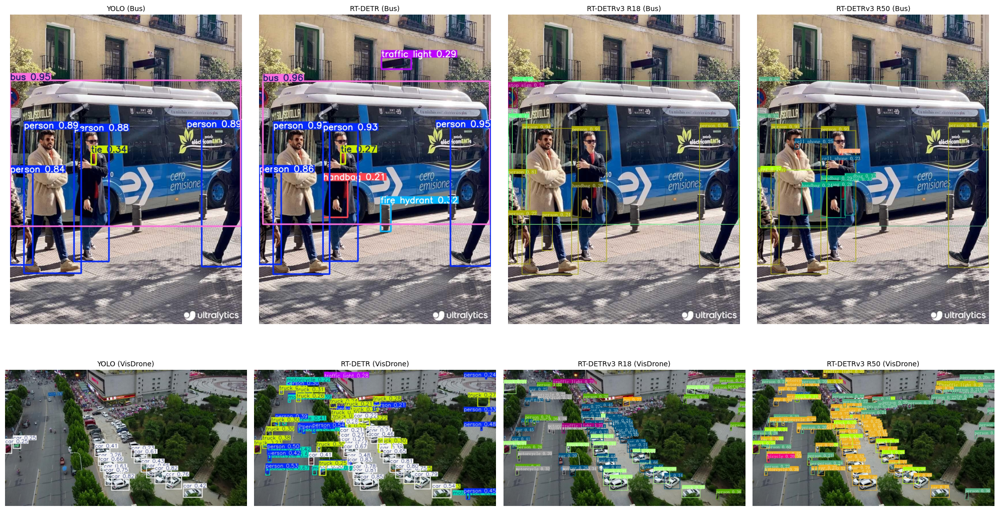

In [38]:
# Output paths for saved images
image_paths = {
    "Bus": {
        "YOLO": '/kaggle/working/RT-DETRv3/output/Bus_yolo_result.jpg',
        "RT-DETR": '/kaggle/working/RT-DETRv3/output/Bus_rtdetr_result.jpg',
        "RT-DETRv3 R18": '/kaggle/working/RT-DETRv3/output/r18_bus/coco_sample.jpg',
        "RT-DETRv3 R50": '/kaggle/working/RT-DETRv3/output/r50_bus/coco_sample.jpg',
    },
    "VisDrone": {
        "YOLO": '/kaggle/working/RT-DETRv3/output/VisDrone_yolo_result.jpg',
        "RT-DETR": '/kaggle/working/RT-DETRv3/output/VisDrone_rtdetr_result.jpg',
        "RT-DETRv3 R18": '/kaggle/working/RT-DETRv3/output/r18_visdrone/0000002_00005_d_0000014.jpg',
        "RT-DETRv3 R50": '/kaggle/working/RT-DETRv3/output/r50_visdrone/0000002_00005_d_0000014.jpg',
    }
}

#  display images
fig, axes = plt.subplots(2, 4, figsize=(20, 12)) 

image_titles = ["Bus", "VisDrone"]
model_titles = ["YOLO", "RT-DETR", "RT-DETRv3 R18", "RT-DETRv3 R50"]

# Loop through images and display them
for row, img_title in enumerate(image_titles):
    for col, model in enumerate(model_titles):
        # Load the image from the path
        img_path = image_paths[img_title][model]
        img = Image.open(img_path)
        
        # Display the image
        axes[row, col].imshow(img)  
        axes[row, col].set_title(f"{model} ({img_title})", fontsize=10)
        axes[row, col].axis('off')  

# Adjust layout and show the plot
plt.tight_layout()
plt.show()


<p style="text-align:center;">
    <font face="Georgia" size=5 color="red"><b>Comparison of inference time  and runtime </b></font>
</p>

In [ ]:
import subprocess
import time

# Start Run-time timer
start_time = time.time()

# Start Inference-time timer
infer_start_time = time.time()

# Define the command
command = [
    "python", "tools/infer.py",
    "-c", "configs/rtdetrv3/rtdetrv3_r18vd_6x_coco.yml",
    "-o", "weights=checkpoints/rtdetrv3_r18vd_6x.pdparams",
    "--infer_img", "/kaggle/input/visdrone2019-det/VisDrone/images/train/0000002_00005_d_0000014.jpg",
    "--output_dir", "output/"
]

# Run the command
subprocess.run(command)  

# End Inference-time timer
infer_end_time = time.time()

# Calculate Inference Time
inference_time = infer_end_time - infer_start_time
print(f"Inference Time: {inference_time} seconds")

# End Run-time timer
end_time = time.time()

# Calculate Run Time
run_time = end_time - start_time
print(f"Run Time: {run_time} seconds")


Inference Time: 6.576362609863281 seconds
Run Time: 6.576635837554932 seconds



0: 640x480 4 persons, 1 bus, 1 tie, 46.8ms
Speed: 2.2ms preprocess, 46.8ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 480)

0: 640x640 4 persons, 1 bus, 2 traffic lights, 1 fire hydrant, 1 stop sign, 1 handbag, 2 ties, 1 potted plant, 55.5ms
Speed: 2.8ms preprocess, 55.5ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)


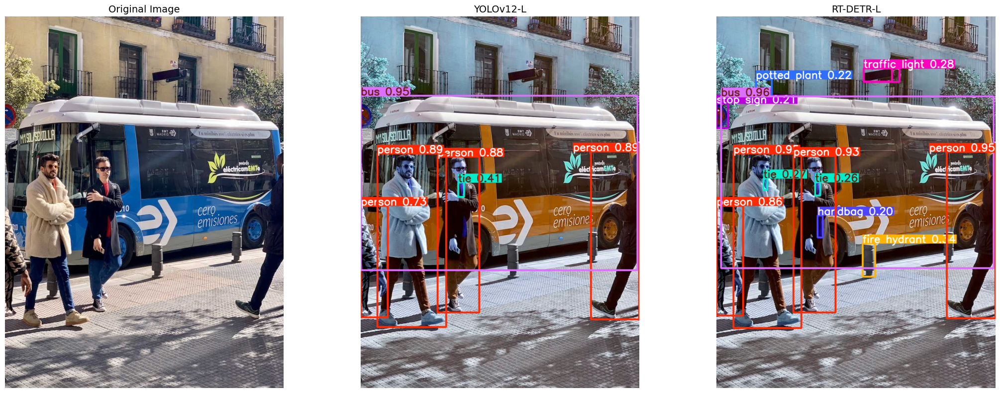

In [40]:
image_url = 'https://ultralytics.com/images/bus.jpg'
response = requests.get(image_url)
image = Image.open(BytesIO(response.content)).convert("RGB")
image_yolo = image.copy()
image_rtdetr = image.copy()

# YOLOv12-L 
yolo_model = YOLO('/kaggle/working/yolov12l.pt')
yolo_results = yolo_model(image_yolo , conf=0.2)
yolo_img = yolo_results[0].plot()

# RT-DETR-L 
rtdetr_model = RTDETR('rtdetr-l.pt')
rtdetr_results = rtdetr_model(image_rtdetr , conf=0.2)
rtdetr_img = rtdetr_results[0].plot()

# show
fig, axes = plt.subplots(1, 3, figsize=(22, 8))

 
axes[0].imshow(image)
axes[0].set_title("Original Image", fontsize=14)
axes[0].axis('off')


axes[1].imshow(yolo_img)
axes[1].set_title("YOLOv12-L", fontsize=14)
axes[1].axis('off')


axes[2].imshow(rtdetr_img)
axes[2].set_title("RT-DETR-L", fontsize=14)
axes[2].axis('off')

plt.tight_layout()
plt.show()



0: 384x640 15 cars, 39.2ms
Speed: 2.1ms preprocess, 39.2ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 640x640 24 persons, 29 cars, 14 motorcycles, 23 trucks, 2 traffic lights, 68.2ms
Speed: 2.4ms preprocess, 68.2ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)


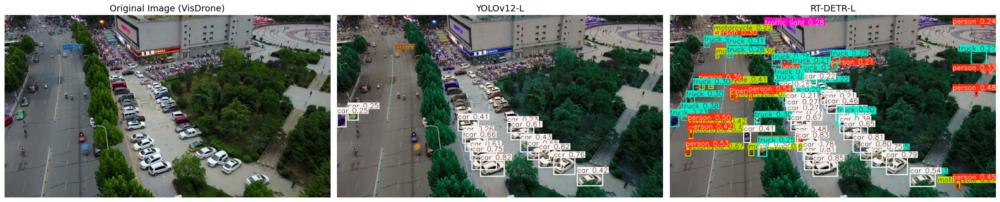

In [41]:

image_path = '/kaggle/input/visdrone2019-det/VisDrone/images/train/0000002_00005_d_0000014.jpg'
image = Image.open(image_path).convert("RGB")
image_yolo = image.copy()
image_rtdetr = image.copy()

# YOLOv12-L 
yolo_model = YOLO('/kaggle/working/yolov12l.pt')
yolo_results = yolo_model(image_yolo , conf=0.2)
yolo_img = yolo_results[0].plot()

# RT-DETR-L
rtdetr_model = RTDETR('rtdetr-l.pt')
rtdetr_results = rtdetr_model(image_rtdetr , conf=0.2)
rtdetr_img = rtdetr_results[0].plot()

# show
fig, axes = plt.subplots(1, 3, figsize=(22, 8))


axes[0].imshow(image)
axes[0].set_title("Original Image (VisDrone)", fontsize=14)
axes[0].axis('off')


axes[1].imshow(yolo_img)
axes[1].set_title("YOLOv12-L", fontsize=14)
axes[1].axis('off')


axes[2].imshow(rtdetr_img)
axes[2].set_title("RT-DETR-L", fontsize=14)
axes[2].axis('off')

plt.tight_layout()
plt.show()


| Model       | Image  | Image Size  | Run Time (ms) | Inference (ms) |
| ------------ | ------ | ----------- | ------------- | -------------- |
| YOLOv12_l    | Bus    | 640x480     | 50.4          | 46.8           |
| RT-DETRv2_l  | Bus    | 640x640     | 58.9          | 55.5           |
| YOLOv12_l    | Street | 384x640     | 42.8          | 39.2           |
| RT-DETRv2_l  | Street | 640x640     | 71.2          | 68.2           |


### Key Points::

* The **YOLOv12\_l** model performs faster and with lower inference time (compared to RT-DETRv2\_l), indicating that it is optimized for object detection in images with specific features and limited time constraints.

* The **RT-DETRv2\_l** model has shown better accuracy in detecting objects (especially with more and varied types of objects). This suggests that RT-DETRv2\_l likely has higher accuracy in detecting different objects, but at the cost of higher processing time.



### Summary:

* If you need faster processing and inference time is a critical factor, **YOLOv12\_l** is the better choice.

* If higher accuracy and the ability to detect a wider variety of objects are more important (especially for more complex images), **RT-DETRv2\_l** provides better performance, although it requires more processing time.


<p style="text-align:center;">
    <font face="Georgia" size=7 color="red"><b>Part 2</b></font>
</p>

<p style="text-align:center;">
    <font face="Georgia" size=5 color="red"><b>RTDETRv3_m</b></font>
</p>

<p style="text-align:center;">
    <font face="Georgia" size=5 color="red"><b>Show Only the Person's class</b></font>
</p>

In [15]:
!mkdir -p checkpoints
!gdown https://drive.google.com/uc?id=12-wqAF8i67eqbocaWPK33d4tFkN2wGi2 -O checkpoints/rtdetrv3_r34vd_6x.pdparams


Downloading...
From (original): https://drive.google.com/uc?id=12-wqAF8i67eqbocaWPK33d4tFkN2wGi2
From (redirected): https://drive.google.com/uc?id=12-wqAF8i67eqbocaWPK33d4tFkN2wGi2&confirm=t&uuid=919698a5-0316-4361-87ae-4a2cc9794b8b
To: /kaggle/working/RT-DETRv3/checkpoints/rtdetrv3_r34vd_6x.pdparams
100%|████████████████████████████████████████| 137M/137M [00:02<00:00, 51.5MB/s]


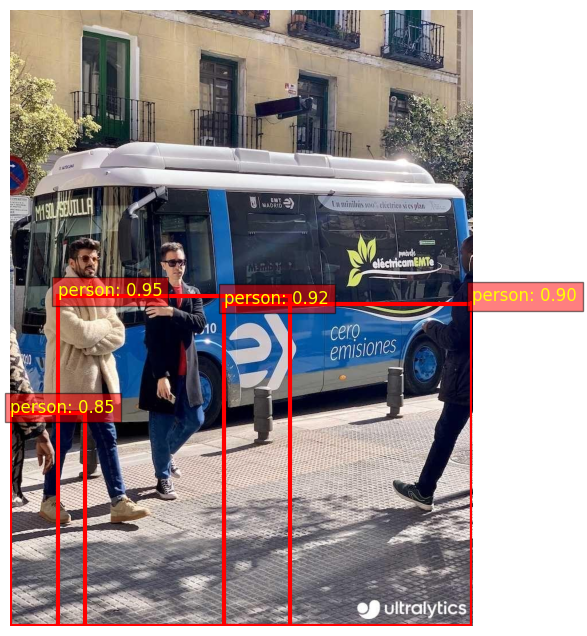

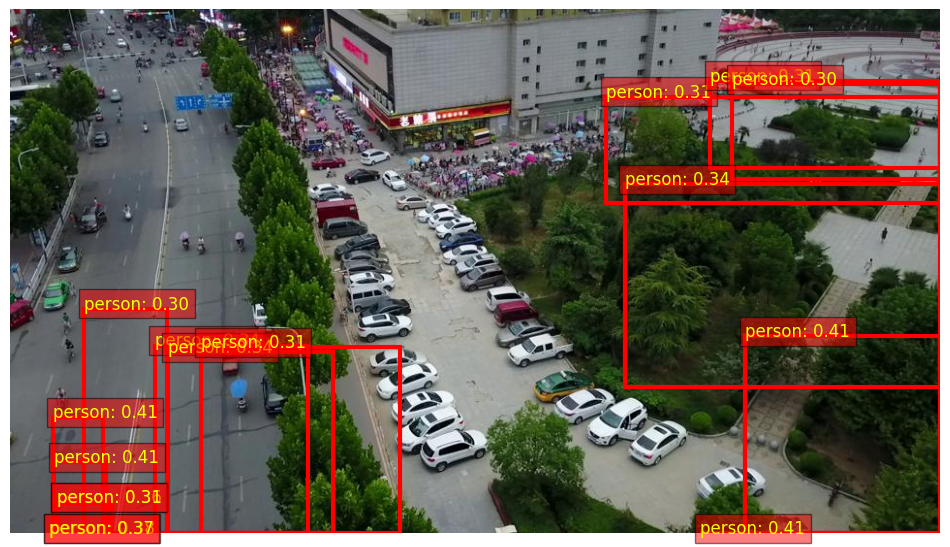

In [42]:
import numpy as np
import matplotlib.patches as patches
import sys
import os

repo_path = '/kaggle/working/RT-DETRv3'  
sys.path.append(repo_path)

from ppdet.core.workspace import load_config, create

config_path = os.path.join(repo_path, 'configs', 'rtdetrv3', 'rtdetrv3_r34vd_6x_coco.yml')
checkpoint_path = os.path.join(repo_path, 'checkpoints', 'rtdetrv3_r34vd_6x.pdparams')

# Load the model and weights
config = load_config(config_path)
model = create(config.architecture)
state_dict = paddle.load(checkpoint_path)
model.set_state_dict(state_dict)
model.eval()

def preprocess_image(image_path):
    image = Image.open(image_path).convert('RGB')
    original_width, original_height = image.size
    
    # Resize to 640x640 for the model
    im = image.resize((640, 640))
    im = np.array(im).astype('float32') / 255.0
    
    mean = np.array([0.485, 0.456, 0.406], dtype=np.float32)
    std = np.array([0.229, 0.224, 0.225], dtype=np.float32)
    im = (im - mean) / std
    
    im = im.transpose((2, 0, 1))
    im_tensor = paddle.to_tensor(im).unsqueeze(0).astype('float32')
    
    im_shape = paddle.to_tensor(np.array([640, 640], dtype=np.float32)).unsqueeze(0)
    
    # scale_factor
    scale_factor = paddle.to_tensor(np.array([640 / original_width, 640 / original_height], dtype=np.float32)).unsqueeze(0)
    
    return image, im_tensor, im_shape, scale_factor

def clamp(val, min_val, max_val):
    return max(min(val, max_val), min_val)

def inference_person(image_path, conf_threshold=0.3):
    image, im_tensor, im_shape, scale_factor = preprocess_image(image_path)
    original_width, original_height = image.size
    
    with paddle.no_grad():
        outputs = model({
            'image': im_tensor,
            'im_shape': im_shape,
            'scale_factor': scale_factor
        })
    
    boxes = outputs['bbox'].numpy()
    
    # Filter for only person class (class 0) 
    person_boxes = [b for b in boxes if b[0] == 0 and b[1] >= conf_threshold]
    
    plt.figure(figsize=(12, 8))
    plt.imshow(image)
    ax = plt.gca()
    
    # Note that the scaling needs to be reversed 
    scale_x = original_width / 640
    scale_y = original_height / 640
    
    for box in person_boxes:
        _, score, x_min, y_min, w, h = box
        
        # Convert the coordinates back to the original image size 
        x_min = clamp(x_min * scale_x, 0, original_width)
        y_min = clamp(y_min * scale_y, 0, original_height)
        w = clamp(w * scale_x, 0, original_width - x_min)
        h = clamp(h * scale_y, 0, original_height - y_min)
        
        rect = patches.Rectangle((x_min, y_min), w, h, linewidth=3, edgecolor='r', facecolor='none')
        ax.add_patch(rect)
        ax.text(x_min, y_min, f'person: {score:.2f}', color='yellow', fontsize=12,
                bbox=dict(facecolor='red', alpha=0.5))
    
    plt.axis('off')
    plt.show()

# Test on two images
inference_person('coco_sample.jpg')
inference_person('/kaggle/input/visdrone2019-det/VisDrone/images/train/0000002_00005_d_0000014.jpg')


<p style="text-align:center;">
    <font face="Georgia" size=5 color="red"><b>Show Only the Person's class with RTDETRv2_l</b></font>
</p>


0: 640x640 4 persons, 68.3ms
Speed: 3.1ms preprocess, 68.3ms inference, 30.5ms postprocess per image at shape (1, 3, 640, 640)


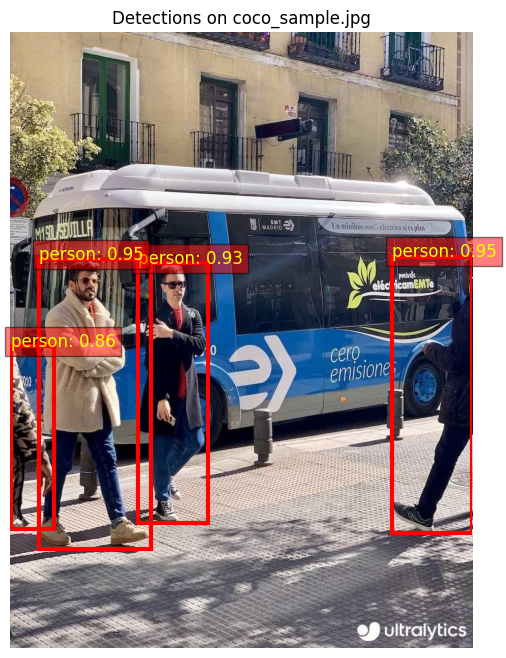


0: 640x640 18 persons, 69.9ms
Speed: 2.5ms preprocess, 69.9ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)


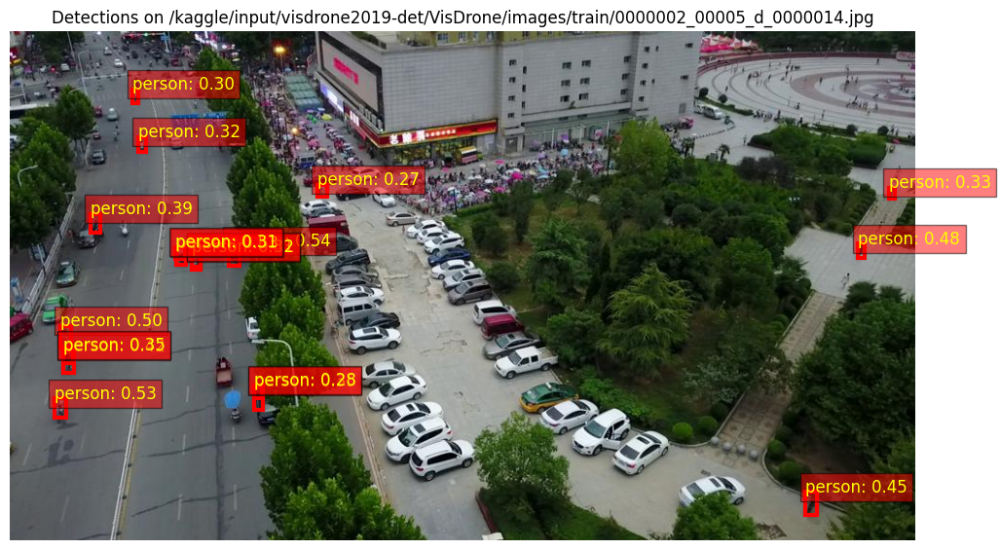

In [ ]:
# Load the Large model
model = RTDETR('rtdetr-l.pt')

# List of image paths
image_paths = [
    'coco_sample.jpg',
    '/kaggle/input/visdrone2019-det/VisDrone/images/train/0000002_00005_d_0000014.jpg'
]

for image_path in image_paths:
    # Load the image
    image = Image.open(image_path).convert('RGB')

    # only for class "person" which is class 0
    results = model(image, classes=[0])  

    # Extract bounding boxes for the "person" class
    person_boxes = results[0].boxes.xyxy.numpy()  
    scores = results[0].boxes.conf.numpy()  

    # Display the image with bounding boxes
    plt.figure(figsize=(12,8))
    plt.imshow(image)
    ax = plt.gca()

    # Draw bounding boxes and labels
    for box, score in zip(person_boxes, scores):
        x1, y1, x2, y2 = box
        rect = plt.Rectangle((x1, y1), x2 - x1, y2 - y1, fill=False, edgecolor='red', linewidth=3)
        ax.add_patch(rect)
        ax.text(x1, y1, f'person: {score:.2f}', fontsize=12, color='yellow', bbox=dict(facecolor='red', alpha=0.5))

    plt.title(f'Detections on {image_path}')
    plt.axis('off')
    plt.show()


<p style="text-align:center;">
    <font face="Georgia" size=7 color="red"><b>Part 3</b></font>
</p>

<p style="text-align:center;">
    <font face="Georgia" size=5 color="red"><b>Load dataset</b></font>
</p>

In [14]:
import os

train_images_dir = '/kaggle/input/signa-coco/train'
valid_images_dir = '/kaggle/input/signa-coco/valid'
test_images_dir = '/kaggle/input/signa-coco/test'


num_train_images = len([f for f in os.listdir(train_images_dir) if f.lower().endswith(('jpg', 'jpeg', 'png'))])
num_valid_images = len([f for f in os.listdir(valid_images_dir) if f.lower().endswith(('jpg', 'jpeg', 'png'))])
num_test_images = len([f for f in os.listdir(test_images_dir) if f.lower().endswith(('jpg', 'jpeg', 'png'))])

print(f"Number of images in train folder: {num_train_images}")
print(f"Number of images in valid folder: {num_valid_images}")
print(f"Number of images in test folder: {num_test_images}")


Number of images in train folder: 2425
Number of images in valid folder: 56
Number of images in test folder: 2


<p style="text-align:center;">
    <font face="Georgia" size=5 color="red"><b>Randomly Display 3 Images</b></font>
</p>

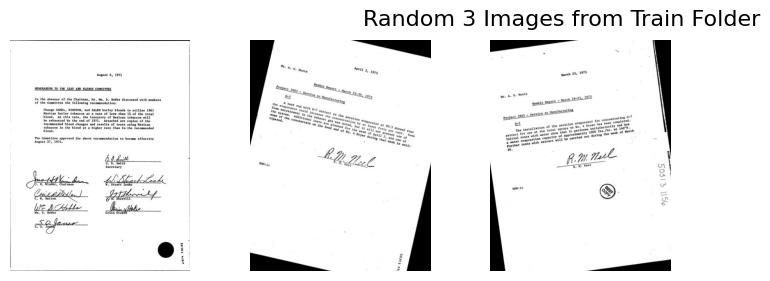

In [4]:
train_img_dir = '/kaggle/input/signa-yolo/train/images'
train_images = [f for f in os.listdir(train_img_dir) if f.lower().endswith(('.jpg', '.jpeg', '.png'))]

 
random_images = random.sample(train_images, 3)

plt.figure(figsize=(15, 3))  
for i, img_name in enumerate(random_images):
    img_path = os.path.join(train_img_dir, img_name)
    img = Image.open(img_path)

    plt.subplot(1, 5, i + 1)
    plt.imshow(img)
    plt.axis('off')

plt.suptitle('Random 3 Images from Train Folder', fontsize=16)
plt.show()


<p style="text-align:center;">
    <font face="Georgia" size=5 color="red"><b>Applying the Model to the Image Before Training</b></font>
</p>


image 1/1 /kaggle/input/signa-yolo/train/images/aah97e00-page02_1_jpg.rf.20cd8b84d1367b68ec99837c3ad875fe.jpg: 640x640 1 book, 68.2ms
Speed: 2.4ms preprocess, 68.2ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)


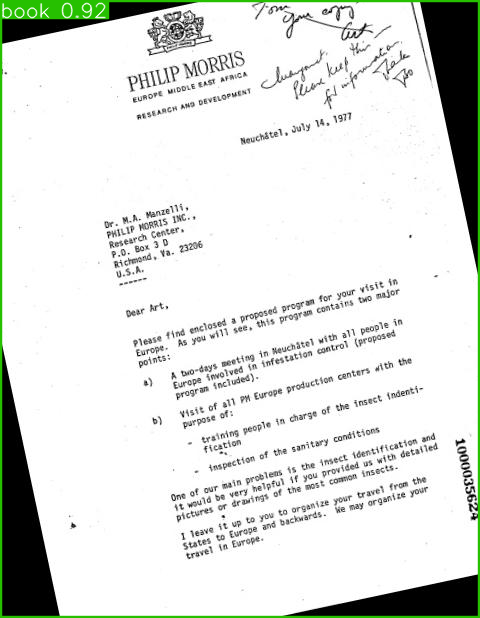


image 1/1 /kaggle/input/signa-yolo/valid/images/aao54e00_2_jpg.rf.eb0197d51e2d729fa403dad09a03bf1e.jpg: 640x640 3 birds, 1 laptop, 66.2ms
Speed: 2.3ms preprocess, 66.2ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)


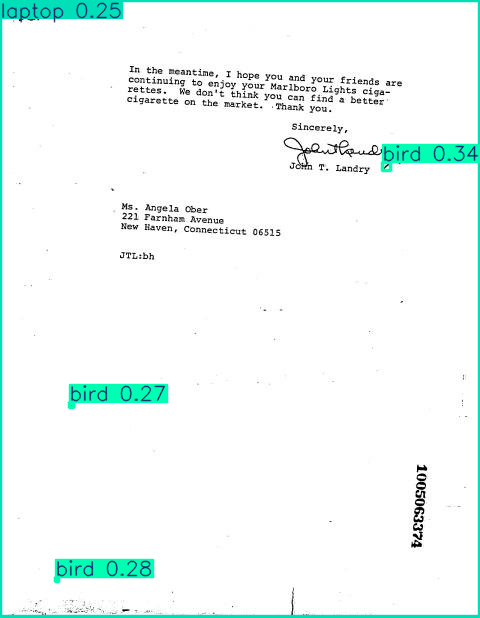

In [8]:
from ultralytics import RTDETR

# Load the model
model = RTDETR('/kaggle/working/rtdetr-l.pt')

# Define image paths
image_paths = [
    '/kaggle/input/signa-yolo/train/images/aah97e00-page02_1_jpg.rf.20cd8b84d1367b68ec99837c3ad875fe.jpg',
    '/kaggle/input/signa-yolo/valid/images/aao54e00_2_jpg.rf.eb0197d51e2d729fa403dad09a03bf1e.jpg'
]

# Loop over both images and apply the model
for image_path in image_paths:
    # Run inference on the image
    results = model(image_path)
    
    # Display the result with bounding boxes
    results[0].show()  


<p style="text-align:center;">
    <font face="Georgia" size=5 color="red"><b>Creating Yaml file</b></font>
</p>

In [13]:
import yaml

data = {
    'path': '/kaggle/input/signa-yolo',  
    'train': 'train/images',
    'val': 'valid/images',
    'nc': 2,  
    'names': {0: 'logo', 1: 'signature'}
}

with open('data.yaml', 'w') as f:
    yaml.dump(data, f, default_flow_style=False)

print("YAML file saved as data.yaml")


YAML file saved as data.yaml


<p style="text-align:center;">
    <font face="Georgia" size=5 color="red"><b>Training & Augmentation</b></font>
</p>

In [ ]:
model = RTDETR('rtdetr-l.pt')  


results = model.train(
    data='data.yaml',
    epochs=10,
    batch=4,
    imgsz=640,
    device='cuda:0',
    degrees=90,
    translate=0.1,
    scale=0.6,
    flipud=0.3,
    fliplr=0.3,
    erasing=0.4,  
)


Ultralytics 8.3.152 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=4, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=data.yaml, degrees=0.0, deterministic=True, device=0, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=10, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=rtdetr-l.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=train, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, overlap_mask=True, patience=100, perspective=0.0, plots=True, pose=12.0, pretrained=True, profile=False, 

100%|██████████| 755k/755k [00:00<00:00, 16.9MB/s]


Overriding model.yaml nc=80 with nc=2
WARNING ⚠️ no model scale passed. Assuming scale='l'.

                   from  n    params  module                                       arguments                     
  0                  -1  1     25248  ultralytics.nn.modules.block.HGStem          [3, 32, 48]                   
  1                  -1  6    155072  ultralytics.nn.modules.block.HGBlock         [48, 48, 128, 3, 6]           
  2                  -1  1      1408  ultralytics.nn.modules.conv.DWConv           [128, 128, 3, 2, 1, False]    
  3                  -1  6    839296  ultralytics.nn.modules.block.HGBlock         [128, 96, 512, 3, 6]          
  4                  -1  1      5632  ultralytics.nn.modules.conv.DWConv           [512, 512, 3, 2, 1, False]    
  5                  -1  6   1695360  ultralytics.nn.modules.block.HGBlock         [512, 192, 1024, 5, 6, True, False]
  6                  -1  6   2055808  ultralytics.nn.modules.block.HGBlock         [1024, 192, 1024, 5, 

100%|██████████| 5.35M/5.35M [00:00<00:00, 71.5MB/s]


AMP: checks passed ✅
train: Fast image access ✅ (ping: 0.1±0.2 ms, read: 5.5±3.5 MB/s, size: 37.2 KB)


train: Scanning /kaggle/input/signa-yolo/train/labels... 2425 images, 0 backgrounds, 38 corrupt: 100%|██████████| 2425/2425 [00:11<00:00, 217.62it/s]

train: /kaggle/input/signa-yolo/train/images/aah97e00-page02_2_png.rf.4a482dfb5add4796057c27a336df84b8.jpg: ignoring corrupt image/label: Label class 2 exceeds dataset class count 2. Possible class labels are 0-1
train: /kaggle/input/signa-yolo/train/images/aah97e00-page02_2_png.rf.7796dadf6792eed5ebad5f9344a3c5a3.jpg: ignoring corrupt image/label: Label class 2 exceeds dataset class count 2. Possible class labels are 0-1
train: /kaggle/input/signa-yolo/train/images/aah97e00-page02_2_png.rf.d741cef0aa04a5aa62f57257b3e13490.jpg: ignoring corrupt image/label: Label class 2 exceeds dataset class count 2. Possible class labels are 0-1
train: /kaggle/input/signa-yolo/train/images/aao54e00_2_png.rf.7424bfd0af7a44d6fd99b3f8db6055eb.jpg: ignoring corrupt image/label: Label class 2 exceeds dataset class count 2. Possible class labels are 0-1
train: /kaggle/input/signa-yolo/train/images/aao54e00_2_png.rf.a1a5b9d7f28dee87fb2102599d8a54e3.jpg: ignoring corrupt image/label: Label class 2 exceeds da

WARNING ⚠️ train: Cache directory /kaggle/input/signa-yolo/train is not writeable, cache not saved.
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))
val: Fast image access ✅ (ping: 2.7±2.6 ms, read: 13.1±2.4 MB/s, size: 47.3 KB)


val: Scanning /kaggle/input/signa-yolo/valid/labels... 56 images, 0 backgrounds, 4 corrupt: 100%|██████████| 56/56 [00:00<00:00, 243.59it/s]

val: /kaggle/input/signa-yolo/valid/images/acr64d00_png.rf.e29fbbfdae0251bd69f6ad5c3d8d0c06.jpg: ignoring corrupt image/label: Label class 2 exceeds dataset class count 2. Possible class labels are 0-1
val: /kaggle/input/signa-yolo/valid/images/aex05f00_1_png.rf.fae28a02314c38fae5605c3e8f247690.jpg: ignoring corrupt image/label: Label class 2 exceeds dataset class count 2. Possible class labels are 0-1
val: /kaggle/input/signa-yolo/valid/images/amw93e00_png.rf.33fd9f41bd03aef07e9608778d418548.jpg: ignoring corrupt image/label: Label class 2 exceeds dataset class count 2. Possible class labels are 0-1
val: /kaggle/input/signa-yolo/valid/images/avb45e00_png.rf.49cb26d1350a947ace21c0c3a33ecc58.jpg: ignoring corrupt image/label: Label class 2 exceeds dataset class count 2. Possible class labels are 0-1
WARNING ⚠️ val: Cache directory /kaggle/input/signa-yolo/valid is not writeable, cache not saved.


Plotting labels to runs/detect/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001667, momentum=0.9) with parameter groups 143 weight(decay=0.0), 206 weight(decay=0.0005), 226 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/train
Starting training for 10 epochs...
Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem  giou_loss   cls_loss    l1_loss  Instances       Size


  0%|          | 0/597 [00:00<?, ?it/s]/usr/local/lib/python3.10/dist-packages/torch/autograd/graph.py:825: UserWarning: grid_sampler_2d_backward_cuda does not have a deterministic implementation, but you set 'torch.use_deterministic_algorithms(True, warn_only=True)'. You can file an issue at https://github.com/pytorch/pytorch/issues to help us prioritize adding deterministic support for this operation. (Triggered internally at ../aten/src/ATen/Context.cpp:91.)
  return Variable._execution_engine.run_backward(  # Calls into the C++ engine to run the backward pass
       1/10      3.63G     0.7723       1.04     0.4954          3        640: 100%|██████████| 597/597 [03:44<00:00,  2.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:02<00:00,  2.76it/s]

                   all         52         53      0.907      0.916      0.949      0.698



      Epoch    GPU_mem  giou_loss   cls_loss    l1_loss  Instances       Size


  0%|          | 0/597 [00:00<?, ?it/s]/usr/local/lib/python3.10/dist-packages/torch/autograd/graph.py:825: UserWarning: grid_sampler_2d_backward_cuda does not have a deterministic implementation, but you set 'torch.use_deterministic_algorithms(True, warn_only=True)'. You can file an issue at https://github.com/pytorch/pytorch/issues to help us prioritize adding deterministic support for this operation. (Triggered internally at ../aten/src/ATen/Context.cpp:91.)
  return Variable._execution_engine.run_backward(  # Calls into the C++ engine to run the backward pass
       2/10      3.83G     0.4233     0.4977     0.1574          5        640: 100%|██████████| 597/597 [03:41<00:00,  2.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  6.46it/s]

                   all         52         53      0.989      0.949      0.961      0.679



      Epoch    GPU_mem  giou_loss   cls_loss    l1_loss  Instances       Size


  0%|          | 0/597 [00:00<?, ?it/s]/usr/local/lib/python3.10/dist-packages/torch/autograd/graph.py:825: UserWarning: grid_sampler_2d_backward_cuda does not have a deterministic implementation, but you set 'torch.use_deterministic_algorithms(True, warn_only=True)'. You can file an issue at https://github.com/pytorch/pytorch/issues to help us prioritize adding deterministic support for this operation. (Triggered internally at ../aten/src/ATen/Context.cpp:91.)
  return Variable._execution_engine.run_backward(  # Calls into the C++ engine to run the backward pass
       3/10      3.83G      0.395     0.4855     0.1367          3        640: 100%|██████████| 597/597 [03:40<00:00,  2.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  6.45it/s]

                   all         52         53      0.936      0.853       0.89      0.654



      Epoch    GPU_mem  giou_loss   cls_loss    l1_loss  Instances       Size


  0%|          | 0/597 [00:00<?, ?it/s]/usr/local/lib/python3.10/dist-packages/torch/autograd/graph.py:825: UserWarning: grid_sampler_2d_backward_cuda does not have a deterministic implementation, but you set 'torch.use_deterministic_algorithms(True, warn_only=True)'. You can file an issue at https://github.com/pytorch/pytorch/issues to help us prioritize adding deterministic support for this operation. (Triggered internally at ../aten/src/ATen/Context.cpp:91.)
  return Variable._execution_engine.run_backward(  # Calls into the C++ engine to run the backward pass
       4/10      3.83G     0.3751     0.4672     0.1292          4        640: 100%|██████████| 597/597 [03:40<00:00,  2.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  6.44it/s]

                   all         52         53      0.985      0.951       0.96      0.743



      Epoch    GPU_mem  giou_loss   cls_loss    l1_loss  Instances       Size


  0%|          | 0/597 [00:00<?, ?it/s]/usr/local/lib/python3.10/dist-packages/torch/autograd/graph.py:825: UserWarning: grid_sampler_2d_backward_cuda does not have a deterministic implementation, but you set 'torch.use_deterministic_algorithms(True, warn_only=True)'. You can file an issue at https://github.com/pytorch/pytorch/issues to help us prioritize adding deterministic support for this operation. (Triggered internally at ../aten/src/ATen/Context.cpp:91.)
  return Variable._execution_engine.run_backward(  # Calls into the C++ engine to run the backward pass
       5/10      3.84G        nan        nan        nan          3        640: 100%|██████████| 597/597 [03:40<00:00,  2.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  6.43it/s]

                   all         52         53      0.912      0.806      0.826      0.655



      Epoch    GPU_mem  giou_loss   cls_loss    l1_loss  Instances       Size


  0%|          | 0/597 [00:00<?, ?it/s]/usr/local/lib/python3.10/dist-packages/torch/autograd/graph.py:825: UserWarning: grid_sampler_2d_backward_cuda does not have a deterministic implementation, but you set 'torch.use_deterministic_algorithms(True, warn_only=True)'. You can file an issue at https://github.com/pytorch/pytorch/issues to help us prioritize adding deterministic support for this operation. (Triggered internally at ../aten/src/ATen/Context.cpp:91.)
  return Variable._execution_engine.run_backward(  # Calls into the C++ engine to run the backward pass
       6/10      3.84G        nan        nan        nan          4        640: 100%|██████████| 597/597 [03:40<00:00,  2.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:00<00:00,  7.07it/s]

                   all         52         53          0          0          0          0



      Epoch    GPU_mem  giou_loss   cls_loss    l1_loss  Instances       Size


  0%|          | 0/597 [00:00<?, ?it/s]/usr/local/lib/python3.10/dist-packages/torch/autograd/graph.py:825: UserWarning: grid_sampler_2d_backward_cuda does not have a deterministic implementation, but you set 'torch.use_deterministic_algorithms(True, warn_only=True)'. You can file an issue at https://github.com/pytorch/pytorch/issues to help us prioritize adding deterministic support for this operation. (Triggered internally at ../aten/src/ATen/Context.cpp:91.)
  return Variable._execution_engine.run_backward(  # Calls into the C++ engine to run the backward pass
       7/10      3.84G     0.3141     0.4105     0.1057          4        640: 100%|██████████| 597/597 [03:40<00:00,  2.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:00<00:00,  7.05it/s]

                   all         52         53          0          0          0          0



      Epoch    GPU_mem  giou_loss   cls_loss    l1_loss  Instances       Size


  0%|          | 0/597 [00:00<?, ?it/s]/usr/local/lib/python3.10/dist-packages/torch/autograd/graph.py:825: UserWarning: grid_sampler_2d_backward_cuda does not have a deterministic implementation, but you set 'torch.use_deterministic_algorithms(True, warn_only=True)'. You can file an issue at https://github.com/pytorch/pytorch/issues to help us prioritize adding deterministic support for this operation. (Triggered internally at ../aten/src/ATen/Context.cpp:91.)
  return Variable._execution_engine.run_backward(  # Calls into the C++ engine to run the backward pass
       8/10      3.84G     0.3055     0.4053    0.09865          4        640: 100%|██████████| 597/597 [03:41<00:00,  2.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  6.92it/s]

                   all         52         53          0          0          0          0



      Epoch    GPU_mem  giou_loss   cls_loss    l1_loss  Instances       Size


  0%|          | 0/597 [00:00<?, ?it/s]/usr/local/lib/python3.10/dist-packages/torch/autograd/graph.py:825: UserWarning: grid_sampler_2d_backward_cuda does not have a deterministic implementation, but you set 'torch.use_deterministic_algorithms(True, warn_only=True)'. You can file an issue at https://github.com/pytorch/pytorch/issues to help us prioritize adding deterministic support for this operation. (Triggered internally at ../aten/src/ATen/Context.cpp:91.)
  return Variable._execution_engine.run_backward(  # Calls into the C++ engine to run the backward pass
       9/10      3.84G     0.2802     0.3915    0.09056          5        640: 100%|██████████| 597/597 [03:42<00:00,  2.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  6.92it/s]

                   all         52         53          0          0          0          0



      Epoch    GPU_mem  giou_loss   cls_loss    l1_loss  Instances       Size


  0%|          | 0/597 [00:00<?, ?it/s]/usr/local/lib/python3.10/dist-packages/torch/autograd/graph.py:825: UserWarning: grid_sampler_2d_backward_cuda does not have a deterministic implementation, but you set 'torch.use_deterministic_algorithms(True, warn_only=True)'. You can file an issue at https://github.com/pytorch/pytorch/issues to help us prioritize adding deterministic support for this operation. (Triggered internally at ../aten/src/ATen/Context.cpp:91.)
  return Variable._execution_engine.run_backward(  # Calls into the C++ engine to run the backward pass
      10/10      3.84G     0.2683     0.3728    0.08558          4        640: 100%|██████████| 597/597 [03:42<00:00,  2.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  6.83it/s]

                   all         52         53          0          0          0          0



10 epochs completed in 0.622 hours.
Optimizer stripped from runs/detect/train/weights/last.pt, 66.1MB
Optimizer stripped from runs/detect/train/weights/best.pt, 66.1MB

Validating runs/detect/train/weights/best.pt...
Ultralytics 8.3.152 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15095MiB)
rt-detr-l summary: 302 layers, 31,987,850 parameters, 0 gradients, 103.4 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  5.16it/s]
/usr/local/lib/python3.10/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/usr/local/lib/python3.10/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


                   all         52         53      0.985       0.95       0.96      0.743
                  logo         14         14       0.97      0.929      0.925      0.722
             signature         39         39          1      0.972      0.995      0.764
Speed: 0.2ms preprocess, 22.0ms inference, 0.0ms loss, 0.4ms postprocess per image
Results saved to runs/detect/train


<p style="text-align:center;">
    <font face="Georgia" size=5 color="red"><b>Evaluation</b></font>
</p>

In [27]:
metrics = model.val(data='data.yaml')
print(f"Precision: {metrics.box.mp:.4f}")
print(f"Recall: {metrics.box.mr:.4f}")
print(f"mAP@0.5: {metrics.box.map50:.4f}")
print(f"mAP@0.5:0.95: {metrics.box.map:.4f}")

Ultralytics 8.3.152 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15095MiB)
rt-detr-l summary: 302 layers, 31,987,850 parameters, 0 gradients, 103.4 GFLOPs
val: Fast image access ✅ (ping: 0.4±0.0 ms, read: 80.7±42.9 MB/s, size: 33.1 KB)


val: Scanning /kaggle/input/signa-yolo/valid/labels... 56 images, 0 backgrounds, 4 corrupt: 100%|██████████| 56/56 [00:00<00:00, 622.46it/s]

val: /kaggle/input/signa-yolo/valid/images/acr64d00_png.rf.e29fbbfdae0251bd69f6ad5c3d8d0c06.jpg: ignoring corrupt image/label: Label class 2 exceeds dataset class count 2. Possible class labels are 0-1
val: /kaggle/input/signa-yolo/valid/images/aex05f00_1_png.rf.fae28a02314c38fae5605c3e8f247690.jpg: ignoring corrupt image/label: Label class 2 exceeds dataset class count 2. Possible class labels are 0-1
val: /kaggle/input/signa-yolo/valid/images/amw93e00_png.rf.33fd9f41bd03aef07e9608778d418548.jpg: ignoring corrupt image/label: Label class 2 exceeds dataset class count 2. Possible class labels are 0-1
val: /kaggle/input/signa-yolo/valid/images/avb45e00_png.rf.49cb26d1350a947ace21c0c3a33ecc58.jpg: ignoring corrupt image/label: Label class 2 exceeds dataset class count 2. Possible class labels are 0-1
WARNING ⚠️ val: Cache directory /kaggle/input/signa-yolo/valid is not writeable, cache not saved.



                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  5.69it/s]
/usr/local/lib/python3.10/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/usr/local/lib/python3.10/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


                   all         52         53      0.986      0.951       0.96      0.743
                  logo         14         14      0.971      0.929      0.925      0.724
             signature         39         39          1      0.974      0.995      0.762
Speed: 2.2ms preprocess, 37.7ms inference, 0.0ms loss, 0.4ms postprocess per image
Results saved to runs/detect/train2
Precision: 0.9857
Recall: 0.9511
mAP@0.5: 0.9600
mAP@0.5:0.95: 0.7427



image 1/1 /kaggle/input/signa-yolo/test/images/aux55d00_png.rf.d7e8cd6144067936a26bf228b2cce1dc.jpg: 640x640 1 signature, 57.6ms
Speed: 3.1ms preprocess, 57.6ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)


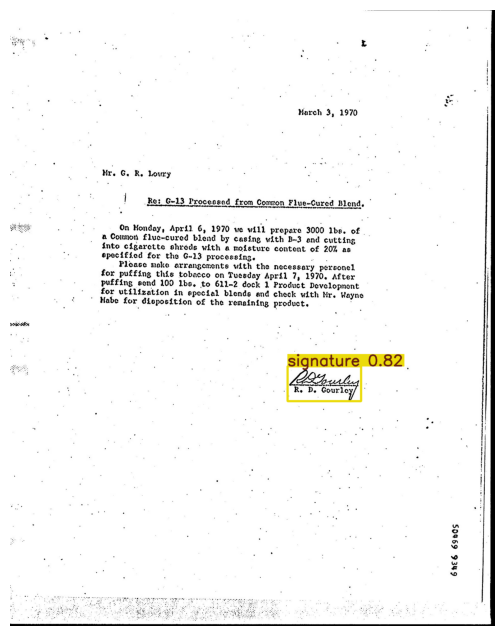

In [30]:
test_image_path = '/kaggle/input/signa-yolo/test/images/aux55d00_png.rf.d7e8cd6144067936a26bf228b2cce1dc.jpg'  

results = model(test_image_path) 

img_out = results[0].plot() 

plt.figure(figsize=(10, 8))
plt.imshow(img_out)
plt.axis('off')
plt.show()


image 1/1 /kaggle/input/signa-yolo/test/images/bad45f00_png.rf.365a79583150abba6465e29f90ad57ef.jpg: 640x640 1 logo, 1 signature, 59.4ms
Speed: 3.6ms preprocess, 59.4ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)


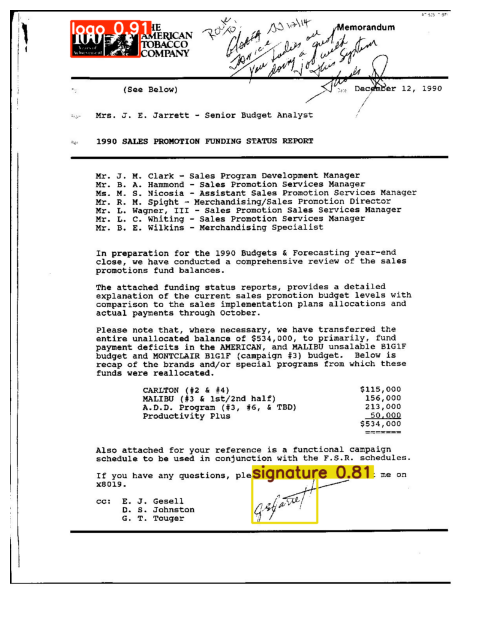

In [31]:
test_image_path = '/kaggle/input/signa-yolo/test/images/bad45f00_png.rf.365a79583150abba6465e29f90ad57ef.jpg'  

results = model(test_image_path) 

img_out = results[0].plot() 

plt.figure(figsize=(10, 8))
plt.imshow(img_out)
plt.axis('off')
plt.show()

In [ ]:
# Sahar Abdi